# Prvi zadatak - Poboljsanje kontrasta slike

In [1]:
#ucitavanje neophodnih biblioteka

from pylab import *

import skimage
from skimage import color
from skimage import exposure 
from skimage import filters 
from skimage import io 
from skimage import util 

from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets

import numpy as np
import imageio.v3 as iio

import ssl
import cv2

- Ucitavanje slike sirokog dinamickog opsega
- Normalizovanje slike

In [130]:
import imageio.v3 as iio
import imageio_freeimage


image1 = iio.imread('../sekvence/street.tif')
image1 = image1/max(image1.flatten())
plt.figure(figsize=(32,20), dpi=80); plt.imshow(image1)

FileNotFoundError: No such file: 'c:\Users\Milica\Documents\FAKS\7 SEMESTAR\DOS\sekvence\street.tif'

- Vidimo da je veci deo slike taman, zbog toga sledi postupak poboljsavanja kontrasta slike

In [3]:
print('Image properties:')
print('  type: ', type(image1))
print('  element type: ', type(image1[0,0]))
print('  size: ', image1.size)
print('  shape: ', image1.shape) #ovde bice kao 
print('  max: ', image1.min())
print('  min: ', image1.max())
print('  mean: ', image1.mean())

Image properties:
  type:  <class 'numpy.ndarray'>
  element type:  <class 'numpy.ndarray'>
  size:  23970816
  shape:  (2448, 3264, 3)
  max:  0.0
  min:  1.0
  mean:  0.19231277922301018


- Zatim sam ispisala parametre slike, vidimo da se dostize i minmalna i maksimalna vrednost piksela ali i da je prosecna vrednost bliza 0, odnosno tamnijim vrednostima

Text(0.5, 1.0, 'Histogram')

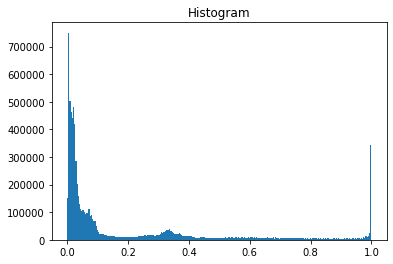

In [4]:
[height, width, planes] = shape(image1)

image1_yuv = color.rgb2yuv(image1)
y_in = image1_yuv[:,:,0]

plt.figure()
plt.hist(y_in.flatten(), bins=256)
plt.title('Histogram')


- Posto je data slika u boji, prebacili smo se iz RGB domena u YUV iz kog mozemo izvuci Y ravan odnosno informaciju o osvetljaju
- Neke metode zahtevaju rad samo na toj ravn jer razvlacenjem histograma sve RGB ravni moze poremetiti odnos boja u njima, a sama Y ravan sadrzi informacije o detaljima
- Iz histograma Y ravni vidimo da je veci deo skoncentrisan u tamnijim delovima ali i da postoji znacajan deo piksela koji je zasicen i predstavlja belu boju (zasicen u obe strane)

## Razvlacenje kontrasta

- Prva metoda je razvlacenje kontrasta
- Prvo trazimo percentile, odnosno iznad i ispod koje vrednosti cemo razvuci kontrast
- Ova metoda je nezahvalna jer cemo ili tamne ili svetle delove odvesti u zasicenost
- Izabrane su vrednosti 2 i 80 jer zelimo da veci deo tamnih piksela razvucemo na veci deo spektra
- Medjutim to znaci da smo sve preko vrednosti koje se pojavljuju vise od 80 posto zakucali na 1
- Sve u svemu, razvukli smo tamne delove i celokupna slika ima bolji osvetljaj mogu se prepoznati delovi

Low_in:  0.003967627085119008
High_in 0.348929386167337


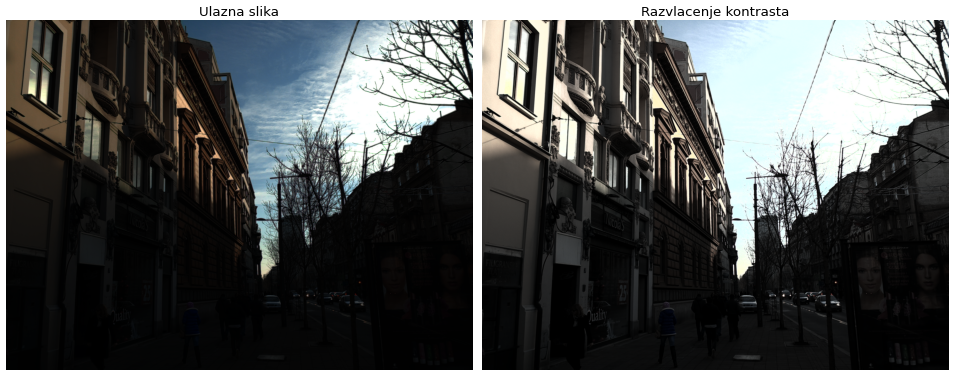

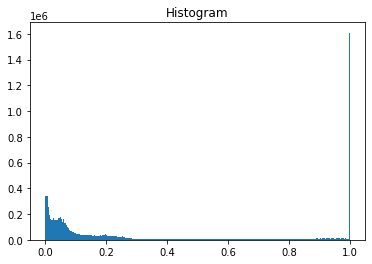

In [5]:

# Izracunavanje percentila
low_in = np.percentile(y_in.flatten(), 2)
high_in = np.percentile(y_in.flatten(), 80)

print("Low_in: ", low_in )
print("High_in", high_in)

y_out = exposure.rescale_intensity(y_in, in_range=(low_in, high_in), out_range=(0,1))

image1_yuv_out = np.zeros(shape(image1_yuv))
image1_yuv_out[:,:,1:3] = image1_yuv[:,:,1:3]
image1_yuv_out[:,:,0] = y_out

image1_rgb_out = color.yuv2rgb(image1_yuv_out)


image1_rgb_out = np.clip(image1_rgb_out, 0, 1)



fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16,8), dpi=60)
ax = axes.ravel()

ax[0].imshow(image1, vmin=0, vmax=1); ax[0].set_axis_off(); ax[0].set_title('Ulazna slika', fontsize=16)
ax[1].imshow(image1_rgb_out, vmin=0, vmax=1); ax[1].set_axis_off(); ax[1].set_title('Razvlacenje kontrasta', fontsize=16)

plt.tight_layout()

plt.figure()
plt.hist(y_out.flatten(), bins=256)
plt.title('Histogram');

## Ekvalizacija histograma

- Data metoda je znacajno bolja, histogram pokazuje veliku uniformnost
- Funkciji smo prosledili samo Y ravan
- Generlno ova metoda ima manu sto uzima celu sliku, i tamne i svetle delove i vrsi onda ekvalizaciju

c:\Users\Milica\AppData\Local\Programs\Python\Python39\lib\site-packages\skimage\_shared\utils.py:316: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


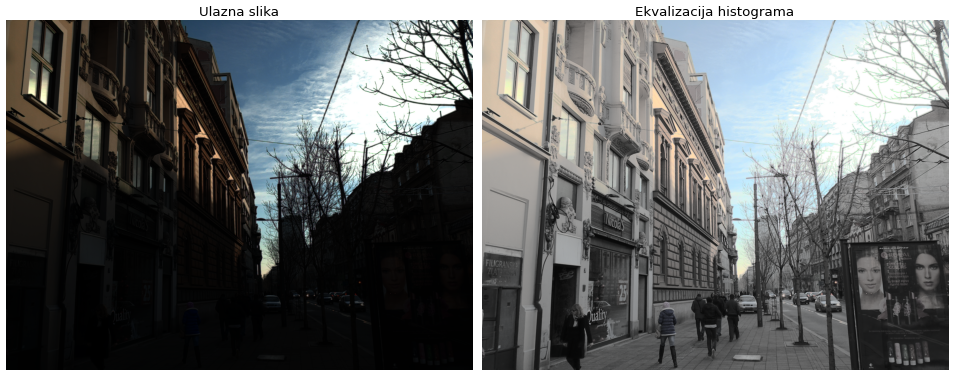

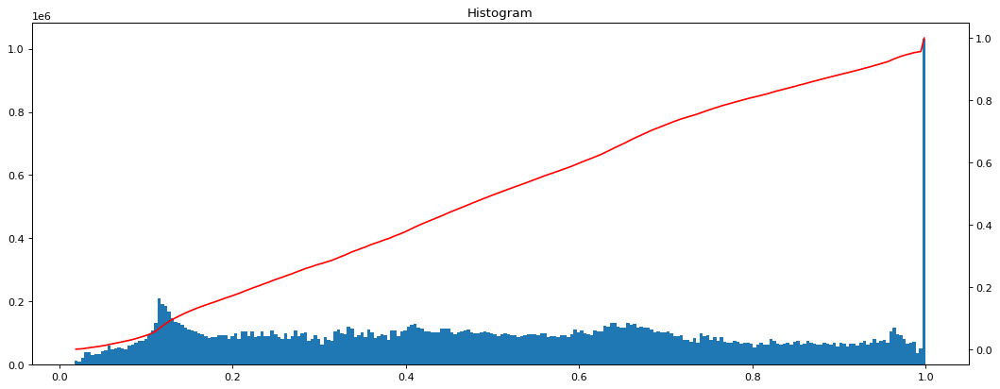

In [6]:

y_out = exposure.equalize_hist(y_in)

image1_yuv_out = np.zeros(shape(image1_yuv))
image1_yuv_out[:,:,1:3] = image1_yuv[:,:,1:3]
image1_yuv_out[:,:,0] = y_out

image1_rgb_out = color.yuv2rgb(image1_yuv_out)

image1_rgb_out = np.clip(image1_rgb_out, 0, 1)
#image1_rgb_out = (image1_rgb_out - np.min(image1_rgb_out))/(np.max(image1_rgb_out) - np.min(image1_rgb_out))

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16,8), dpi=60)
ax = axes.ravel()

ax[0].imshow(image1, vmin=0, vmax=1); ax[0].set_axis_off(); ax[0].set_title('Ulazna slika', fontsize=16)
ax[1].imshow(image1_rgb_out, vmin=0, vmax=1); ax[1].set_axis_off(); ax[1].set_title('Ekvalizacija histograma', fontsize=16)

plt.tight_layout()

fig, ax = plt.subplots(figsize=(16,6), dpi=80)
ax_cdf = ax.twinx()
ax.hist(image1_rgb_out.flatten(), bins=256);
ax.set_title('Histogram');
img_cdf,bins= exposure.cumulative_distribution(image1_rgb_out);
ax_cdf.plot(bins, img_cdf, 'r');


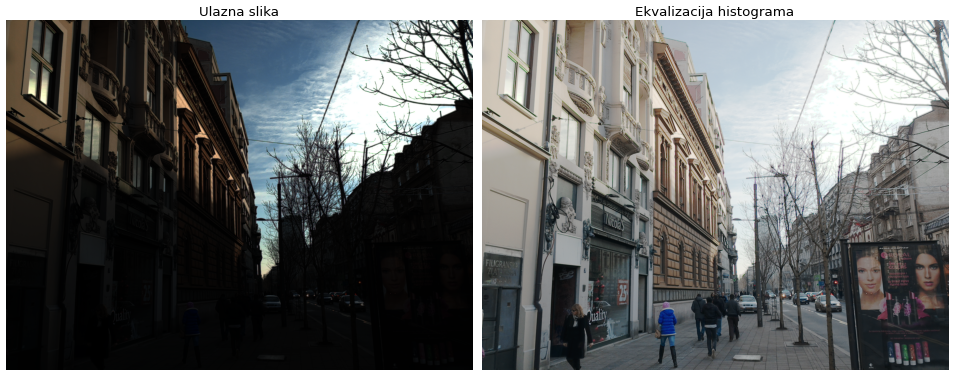

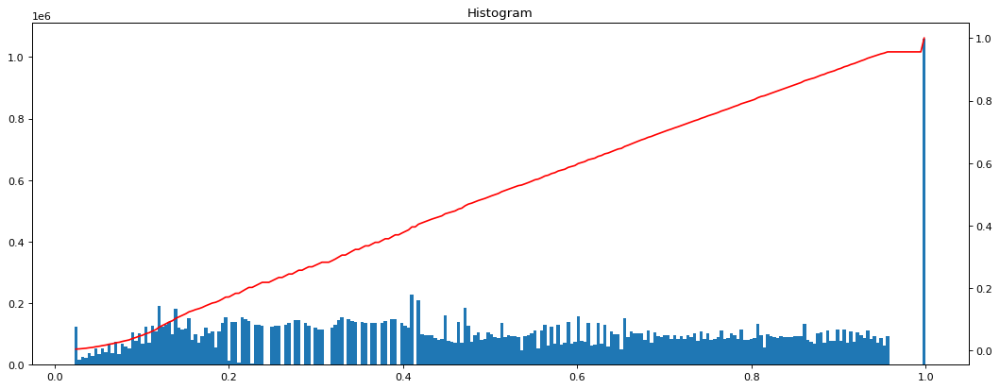

In [7]:
image1_rgb_out = exposure.equalize_hist(image1)
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16,8), dpi=60)
ax = axes.ravel()

ax[0].imshow(image1, vmin=0, vmax=1); ax[0].set_axis_off(); ax[0].set_title('Ulazna slika', fontsize=16)
ax[1].imshow(image1_rgb_out, vmin=0, vmax=1); ax[1].set_axis_off(); ax[1].set_title('Ekvalizacija histograma', fontsize=16)

plt.tight_layout()

fig, ax = plt.subplots(figsize=(16,6), dpi=80)
ax_cdf = ax.twinx()
ax.hist(image1_rgb_out.flatten(), bins=256);
ax.set_title('Histogram');
img_cdf,bins= exposure.cumulative_distribution(image1_rgb_out);
ax_cdf.plot(bins, img_cdf, 'r');

## Adaptivna ekvalizacija sa ogranicenjem kontrasta

- ova metoda mnogo bolja jer radi adaptivnu ekvalizaciju, odnosno svaki region posebno obradjuje i uzma u obzir osvetljaj u tom delu
- ako se ne radi ogranicenje kontrasta dolazi do prenaglasenih delova jer imamo velike koncentracije odredjenog piksela i samim tim iskace i sum i dolazi do neprirodnog izgleda
- ako se stavi premala vrednost ne dolazi do poboljsavanja kontrasta slike
- rezultat nije los, vide se svi delovi ali ipak neki su prenaglaseni

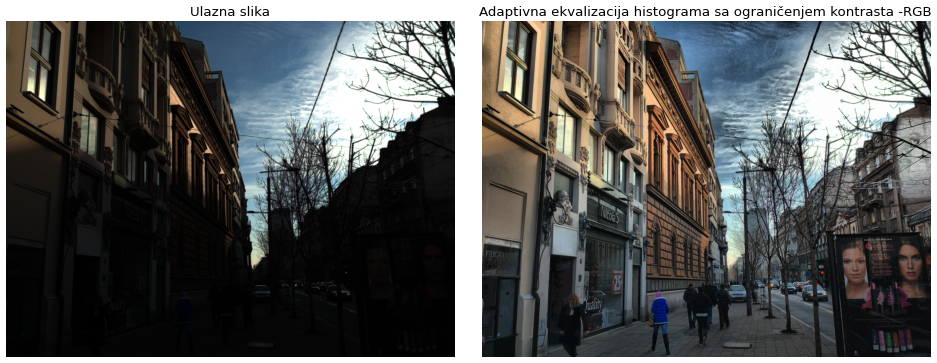

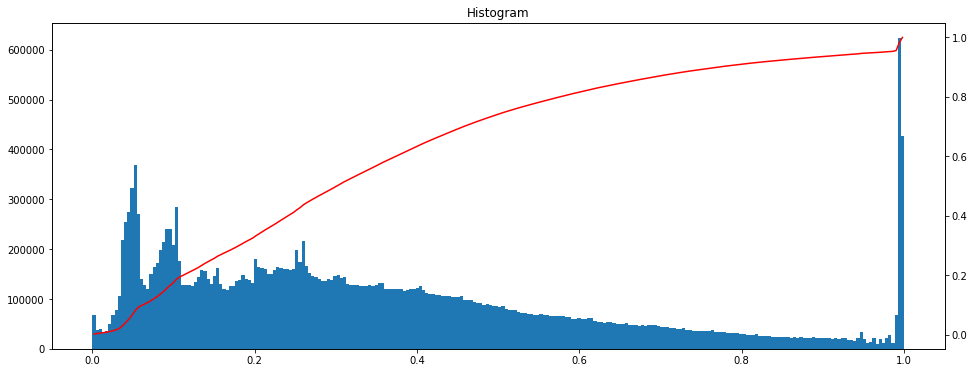

In [129]:
image1_rgb_out = exposure.equalize_adapthist(image1, clip_limit=0.05)

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16,6), dpi=60)
ax = axes.ravel()

ax[0].imshow(image1, vmin=0, vmax=1); ax[0].set_axis_off(); ax[0].set_title('Ulazna slika', fontsize=16)
ax[1].imshow(image1_rgb_out, vmin=0, vmax=1); ax[1].set_axis_off(); ax[1].set_title('Adaptivna ekvalizacija histograma sa ograničenjem kontrasta -RGB', fontsize=16)

plt.tight_layout()

fig, ax = plt.subplots(figsize=(16,6))
ax_cdf = ax.twinx()
ax.hist(image1_rgb_out.flatten(), bins=256);
ax.set_title('Histogram');
img_cdf,bins= exposure.cumulative_distribution(image1_rgb_out);
ax_cdf.plot(bins, img_cdf, 'r');

## Stepena funkcija

- Transformacija gde svaki piksel stepenom funkcijom transforimesemo u izlazni
- Oblik takav da ako je parametar c manji od nule popravljamo osvetljenost cele slike a ako je veci od jedan znacajno je zatamljujemo
- Najbolj prarametar c za datu sliku je 0.4 koji znacajno poboljsava kontrast slike


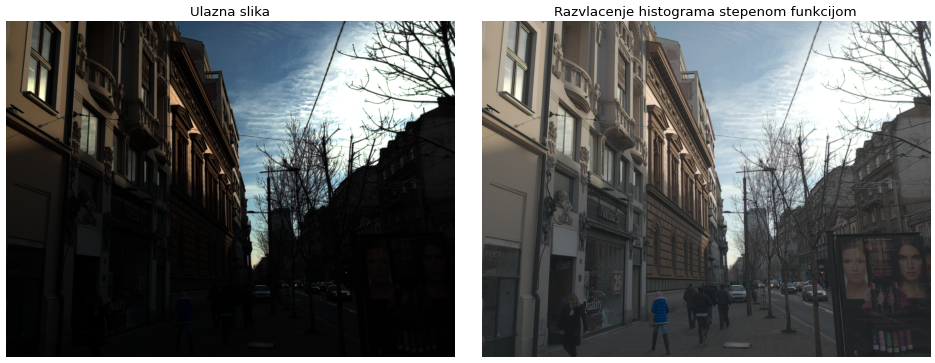

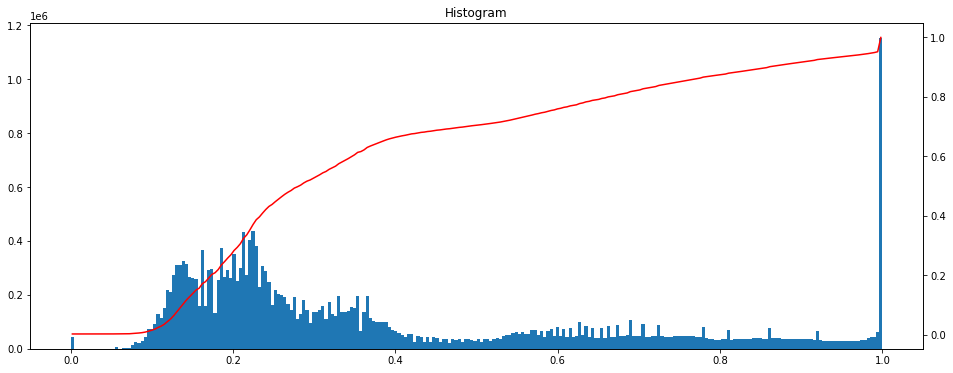

In [12]:
c = 0.40
image1_rgb_out = image1**c


fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16,6), dpi=60)
ax = axes.ravel()

ax[0].imshow(image1, vmin=0, vmax=1); ax[0].set_axis_off(); ax[0].set_title('Ulazna slika', fontsize=16)
ax[1].imshow(image1_rgb_out, vmin=0, vmax=1); ax[1].set_axis_off(); ax[1].set_title('Razvlacenje histograma stepenom funkcijom', fontsize=16)

plt.tight_layout()

fig, ax = plt.subplots(figsize=(16,6))
ax_cdf = ax.twinx()
ax.hist(image1_rgb_out.flatten(), bins=256);
ax.set_title('Histogram');
img_cdf,bins= exposure.cumulative_distribution(image1_rgb_out);
ax_cdf.plot(bins, img_cdf, 'r');

## Logaritamska funkcija

- Za sad najbolja transformacija, isto kao i stepena poboljsava osvetljenost cele slike, odnosno razvlaci kontrast
- Sto je parametar c manji slika je tamnija, povecanjem postaje sve svetlija i bolje razvucen kontrast dobijamo
- Od svih metoda najbolje cuva i odnos boja


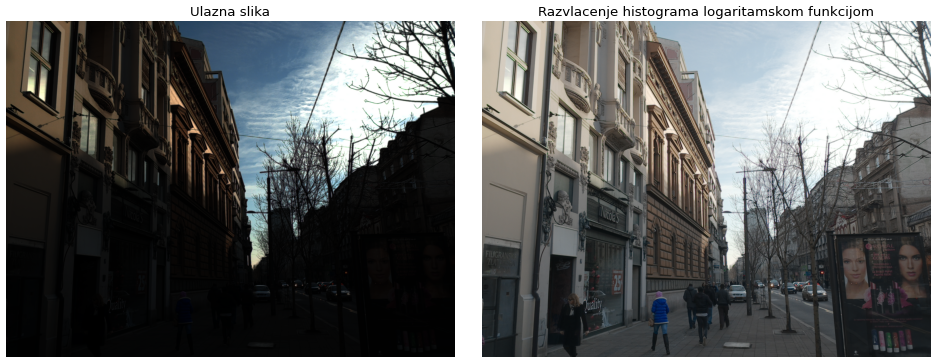

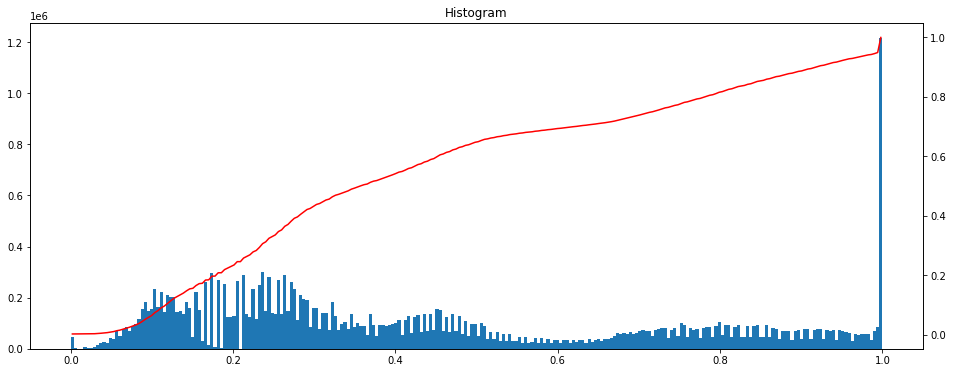

In [14]:
c = 2
image1_rgb_out = log(1 + (10**c)*image1)/log(1+10**c)


fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16,6), dpi=60)
ax = axes.ravel()

ax[0].imshow(image1, vmin=0, vmax=1); ax[0].set_axis_off(); ax[0].set_title('Ulazna slika', fontsize=16)
ax[1].imshow(image1_rgb_out, vmin=0, vmax=1); ax[1].set_axis_off(); ax[1].set_title('Razvlacenje histograma logaritamskom funkcijom', fontsize=16)

plt.tight_layout()

fig, ax = plt.subplots(figsize=(16,6))
ax_cdf = ax.twinx()
ax.hist(image1_rgb_out.flatten(), bins=256);
ax.set_title('Histogram');
img_cdf,bins= exposure.cumulative_distribution(image1_rgb_out);
ax_cdf.plot(bins, img_cdf, 'r');

In [15]:
imageOut = util.img_as_ubyte(image1_rgb_out)
io.imsave( "street_out.jpg",imageOut)

# Drugi zadatak - Izostravanje slike

- ucitavanje slike

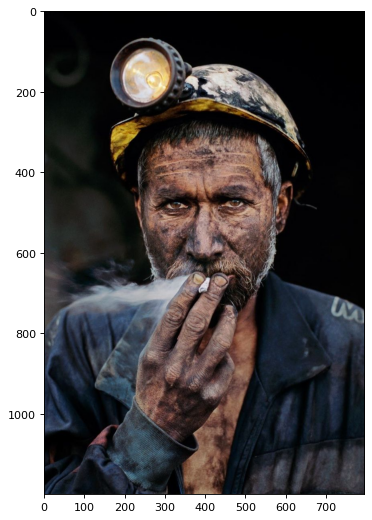

In [16]:

from scipy import ndimage

image2 = iio.imread('miner.jpg')

plt.figure(figsize=(16,8), dpi=80); plt.imshow(image2);

- ispisivanje parametara slike

In [17]:
print('Image properties:')
print('  type: ', type(image2))
print('  element type: ', type(image2[0,0]))
print('  size: ', image2.size)
print('  shape: ', image2.shape) #ovde bice kao 
print('  max: ', image2.min())
print('  min: ', image2.max())
print('  mean: ', image2.mean())

Image properties:
  type:  <class 'numpy.ndarray'>
  element type:  <class 'numpy.ndarray'>
  size:  2865600
  shape:  (1200, 796, 3)
  max:  0
  min:  255
  mean:  47.83177100781686


## Izostravanje slike koriscenjem Laplasijana

- prvo se izdvaja Y ravan slike
- primenjuje se korelacija sa Laplasijan maskom, primenjena je najcesca maska
- oduzima se od orginalne slike cime se izostravaju prelazi
- vraca se u RGB sliku
- znacajno se vidi izostravanje bez isticanja suma

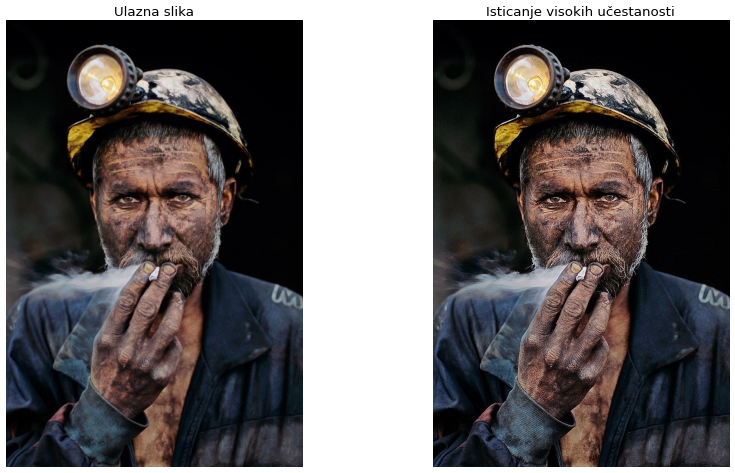

In [18]:
image2 = util.img_as_float(image2)

image2_yuv = color.rgb2yuv(image2)
image2_y = image2_yuv[:,:,0]

laplacian_mask = np.array([ [0,  1, 0],
                            [1, -4, 1],
                            [0,  1, 0] ])

image2_lap = ndimage.correlate(image2_y, laplacian_mask)
image2_sharp = image2_y - image2_lap

image2_sharp = np.clip(image2_sharp, 0, 1)

image2_yuv_out = np.zeros(shape(image2_yuv))
image2_yuv_out[:,:,1:3] = image2_yuv[:,:,1:3]
image2_yuv_out[:,:,0] = image2_sharp


image2_rgb_out = color.yuv2rgb(image2_yuv_out)

image2_rgb_out = np.clip(image2_rgb_out, 0, 1)

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16,8), dpi=60)
ax = axes.ravel()

ax[0].imshow(image2, vmin=0, vmax=1); ax[0].set_axis_off(); ax[0].set_title('Ulazna slika', fontsize=16)
ax[1].imshow(image2_rgb_out, vmin=0, vmax=1); ax[1].set_axis_off(); ax[1].set_title('Isticanje visokih učestanosti', fontsize=16)

plt.tight_layout()

## Unsharp mask

- Isticanje visokih ucestanosti
- Prvo se zamucuje originalna slika sa BOX filterom
- Oduzima se od originalne cime dobijamo izostrenu sliku (prelaze)
- Sad te prelaze mozemo da povecamo vise puta i vratimo na originalnu sliku
- Izabran je parametar 3 , ako se uzme manja vrednost ne izostrava se dovoljno dobro, a ako se poveca dolazi do prenaglasavanja i neprirodnog izgleda(takodje povecavamo i sum)

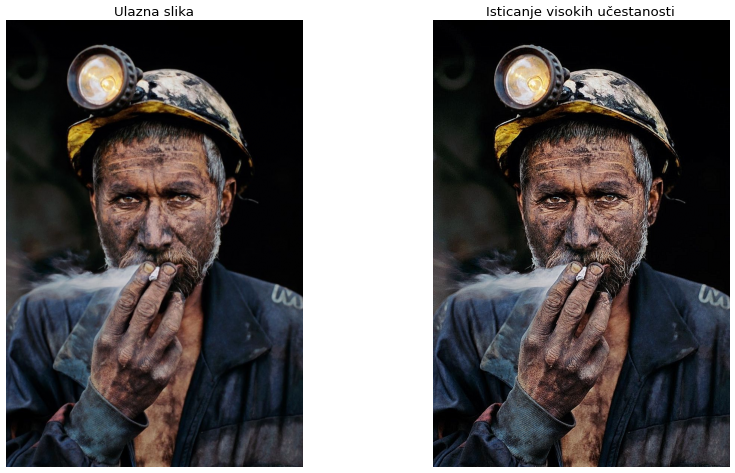

In [19]:
lowpass_mask = np.ones(shape=(3,3))/9
image2_y_blurred = ndimage.correlate(image2_y, lowpass_mask)
image2_y_details = image2_y - image2_y_blurred

image2_y_sharp = image2_y + 3*image2_y_details

image2_yuv_out = np.zeros(shape(image2_yuv))
image2_yuv_out[:,:,1:3] = image2_yuv[:,:,1:3]
image2_yuv_out[:,:,0] = image2_y_sharp 


image2_rgb_out = color.yuv2rgb(image2_yuv_out)

image2_rgb_out = np.clip(image2_rgb_out, 0, 1)

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16,8), dpi=60)
ax = axes.ravel()

ax[0].imshow(image2, vmin=0, vmax=1); ax[0].set_axis_off(); ax[0].set_title('Ulazna slika', fontsize=16)
ax[1].imshow(image2_rgb_out, vmin=0, vmax=1); ax[1].set_axis_off(); ax[1].set_title('Isticanje visokih učestanosti', fontsize=16)

plt.tight_layout()

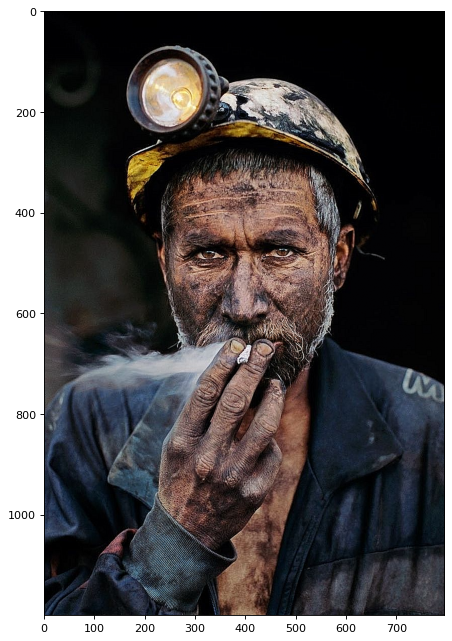

In [20]:
plt.figure(figsize=(16,10), dpi=80); plt.imshow(image2_rgb_out);

- izabrana je druga metoda jer je slika malo izostrenija od prvog

In [21]:
imageOut = util.img_as_ubyte(image1_rgb_out)
io.imsave( "miner_sharp.jpg",imageOut)

# Treci zadatak - implementacija CLAHE metode

In [103]:
def dosCLAHE(imgIn, numTiles = [8,8], limit = 0.01):


    # uctavanje i provera nedozvoljenih vrednosti

    

    if imgIn.ndim == 3:
        img_yuv = color.rgb2yuv(imgIn)
        img_in = img_yuv[:,:,0]
    elif imgIn.ndim == 2:
        img_in = imgIn
    else:
        print("Greska u dimenizijama slike")
        return    
    
    if numTiles[0] > img_in.shape[0]:
        print("Prevelik broj blokova po vertikali")
        return
    
    if numTiles[1] > img_in.shape[1]:
        print("Preveliki broj blokova po horziontali")
        return


    if limit < 0 or limit > 1:
        print("Limit nije odgovarajuci")
        return
    

    #odredjivanje dimenzija
        
    img_in = util.img_as_ubyte(img_in)
    
    
    [height_in, width_in] = img_in.shape

   # odredjivanje dimenizja blokova i padd-ovanje

    if height_in % numTiles[0] == 0:
        dimBlockX = height_in/numTiles[0]
        height_new = height_in
        add_x = 0
    else:
        dimBlockX = ceil(height_in / numTiles[0])
        height_new = dimBlockX*numTiles[0]
        add_x = int(height_new-height_in)

    
    if width_in % numTiles[1] == 0:
        dimBlockY = width_in/numTiles[1]
        width_new = width_in
        add_y = 0
    else:
        dimBlockY = ceil(width_in / numTiles[1])
        width_new = dimBlockY*numTiles[1]
        add_y = int(width_new- width_in)


 
    # dopunjvaju se kao reflektovane vrednosti
    img = np.pad(img_in, ((add_x//2, add_x - add_x//2), (add_y//2,add_y - add_y//2 )),'reflect')



   


    # deo za histogram
    def equal_hist(img):
        
        #odredjivanje histograma i normalizovanog histograma
        pixels = np.arange(0,256)
        histogram = np.array([np.count_nonzero(img.flatten() == i) for i in pixels])
        
        histogram_norm = histogram/np.sum(histogram)

    
        
        accum =   np.sum(histogram_norm[np.where(histogram_norm>limit)] - limit)
        
        histogram_norm[np.where(histogram_norm>limit)] = limit
        histogram_norm_clip = histogram_norm + accum/256
        cum_distrb = np.cumsum(histogram_norm_clip)

        #vraca se kumulativna raspodela
       
        return cum_distrb
        


 

    
    #odredjivanje histograma za svaki blok ponaosob
    cum_distrb_blocks = np.zeros((numTiles[0], numTiles[1], 256))

    
    dimBlockX = int(dimBlockX)
    dimBlockY = int(dimBlockY)

    height_new = int(height_new)
    width_new = int(width_new)
    


    for x in range(0,numTiles[0]):
        for y in range(0,numTiles[1]):
           
           cum_distrb_blocks[x,y] = equal_hist(img[x*dimBlockX:(x+1)*(dimBlockX), y*dimBlockY:(y+1)*(dimBlockY)])
        

    imgOut = np.zeros(img.shape)    
  
    x_ax = np.arange(0, height_new).astype(int)
    y_ax = np.arange(0, width_new).astype(int)
    
    x0 = dimBlockX* (x_ax // dimBlockX)
    y0 = dimBlockY* (y_ax // dimBlockY)

    X0,Y0 = meshgrid(x0,y0)

    xc = dimBlockX* (x_ax // dimBlockX) + (dimBlockX-1)/2 #koordinate centra po pikselu
    yc = dimBlockY* (y_ax // dimBlockY) + (dimBlockY-1)/2 

    xc_block = xc[::dimBlockX].astype(int) #koordinate centra bloka
    yc_block = yc[::dimBlockY].astype(int)

   

   

    P = np.zeros(img.shape)
    Q = np.zeros(img.shape)
    R = np.zeros(img.shape)
    S = np.zeros(img.shape)

    a = np.zeros(img.shape)
    b = np.zeros(img.shape)
    c = np.zeros(img.shape)
    d = np.zeros(img.shape)

    # Odredjivanje P,Q,R,S,a,b,c,d vrednosti za svaki piksel
    
    for x in x_ax:
        for y in y_ax:
           
            
            block_x = x//dimBlockX
            block_y = y//dimBlockY


            # prvi slucaj

            if x - xc[x] < 0 and y - yc[y] < 0:

                if block_x-1 < 0 and block_y-1 >=0:
                    P[x,y] = cum_distrb_blocks[block_x, block_y-1,img[x,y]]
                    c[x,y] = 0
                    a[x,y] = y-yc_block[block_y-1]
                    Q[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    b[x,y] = yc_block[block_y]-y
                    S[x,y] = cum_distrb_blocks[block_x, block_y-1,img[x,y]]
                    d[x,y] = xc_block[block_x] - x
                    R[x,y] = cum_distrb_blocks[block_x,block_y, img[x,y]]
                   

                if block_y-1 <0 and block_x-1 >= 0:
                    P[x,y] = cum_distrb_blocks[block_x-1, block_y,img[x,y]]
                    c[x,y] = x-xc_block[block_x-1]
                    a[x,y] = 0  
                    Q[x,y] = cum_distrb_blocks[block_x-1, block_y,img[x,y]]  
                    b[x,y] = yc_block[block_y]-y
                    S[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    d[x,y] = xc_block[block_x] - x
                    R[x,y] = cum_distrb_blocks[block_x,block_y, img[x,y]]

                if block_x-1 <0 and   block_y-1 <0:
                    P[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    c[x,y]  = 0
                    a[x,y] = 0
                    Q[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    b[x,y] = yc_block[block_y]-y
                    S[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    d[x,y] = xc_block[block_x] - x
                    R[x,y] = cum_distrb_blocks[block_x,block_y, img[x,y]]


                if block_x-1 >=0 and   block_y-1 >=0:
                    P[x,y] = cum_distrb_blocks[block_x-1, block_y-1,img[x,y]]
                    c[x,y] = x-xc_block[block_x-1]
                    a[x,y] = y-yc_block[block_y-1]
                    Q[x,y] = cum_distrb_blocks[block_x-1, block_y,img[x,y]]
                    b[x,y] = yc_block[block_y]-y
                    S[x,y] = cum_distrb_blocks[block_x, block_y-1,img[x,y]]
                    d[x,y] = xc_block[block_x] - x
                    R[x,y] = cum_distrb_blocks[block_x,block_y, img[x,y]]

               

                

            # drugi slucaj

            if x - xc[x] >= 0 and y - yc[y] < 0:

                if block_x+1 >= numTiles[0] & block_y-1 >= 0:
                    P[x,y] = cum_distrb_blocks[block_x, block_y-1,img[x,y]]
                    c[x,y] = x-xc_block[block_x]
                    a[x,y] = y-yc_block[block_y-1]
                    Q[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    b[x,y] = yc_block[block_y]-y
                    S[x,y] = cum_distrb_blocks[block_x, block_y-1,img[x,y]]
                    d[x,y] = 0
                    R[x,y] = cum_distrb_blocks[block_x,block_y, img[x,y]]  

                if block_y-1 <0 and block_x+1 < numTiles[0]:
                    P[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    c[x,y] = x-xc_block[block_x]
                    a[x,y] = 0
                    Q[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    b[x,y] = yc_block[block_y]-y
                    S[x,y] = cum_distrb_blocks[block_x+1, block_y,img[x,y]]
                    d[x,y] = xc_block[block_x+1] - x
                    R[x,y] = cum_distrb_blocks[block_x+1,block_y, img[x,y]] 
                    
                if block_y-1 <0 and block_x+1 >= numTiles[0]:
                    P[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    c[x,y] = x-xc_block[block_x]
                    a[x,y]  = 0
                    Q[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    b[x,y] = yc_block[block_y]-y
                    S[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    d[x,y] = 0
                    R[x,y] = cum_distrb_blocks[block_x,block_y, img[x,y]]  


                if block_y-1 >=0 and block_x+1 < numTiles[0]:
                    P[x,y] = cum_distrb_blocks[block_x, block_y-1,img[x,y]]
                    c[x,y] = x-xc_block[block_x]
                    a[x,y] = y-yc_block[block_y-1]
                    Q[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    b[x,y] = yc_block[block_y]-y
                    S[x,y] = cum_distrb_blocks[block_x+1, block_y-1,img[x,y]]
                    d[x,y] = xc_block[block_x+1] - x
                    R[x,y] = cum_distrb_blocks[block_x+1,block_y, img[x,y]]  


            # treci slucaj        

            if x - xc[x] < 0 and y - yc[y] >= 0:

                if block_x-1 < 0 and block_y+1 < numTiles[1]:
                    P[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    c[x,y] = 0
                    a[x,y] = y-yc_block[block_y]
                    Q[x,y] = cum_distrb_blocks[block_x, block_y+1,img[x,y]]
                    b[x,y] = yc_block[block_y+1]-y
                    S[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    d[x,y] = xc_block[block_x] - x
                    R[x,y] = cum_distrb_blocks[block_x,block_y+1, img[x,y]]

                if block_x-1 >=0 and block_y+1 >= numTiles[1]:
                    P[x,y] = cum_distrb_blocks[block_x-1, block_y,img[x,y]]
                    c[x,y] = x-xc_block[block_x-1]
                    a[x,y] = y-yc_block[block_y]
                    Q[x,y] = cum_distrb_blocks[block_x-1, block_y,img[x,y]]
                    b[x,y] = 0
                    S[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    d[x,y] = xc_block[block_x] - x
                    R[x,y] = cum_distrb_blocks[block_x,block_y, img[x,y]]

                if block_x-1 <0 and   block_y+1 >= numTiles[1]:
                    P[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    c[x,y]  = 0
                    a[x,y] = y-yc_block[block_y]
                    Q[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    b[x,y] = 0
                    S[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    d[x,y] = xc_block[block_x] - x
                    R[x,y] = cum_distrb_blocks[block_x,block_y, img[x,y]]
                 


                if block_x-1 >=0 and   block_y+1 < numTiles[1]:
                    P[x,y] = cum_distrb_blocks[block_x-1, block_y,img[x,y]]
                    c[x,y] = x-xc_block[block_x-1]
                    a[x,y] = y-yc_block[block_y]
                    Q[x,y] = cum_distrb_blocks[block_x-1, block_y+1,img[x,y]]
                    b[x,y] = yc_block[block_y+1]-y
                    S[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    d[x,y] = xc_block[block_x] - x
                    R[x,y] = cum_distrb_blocks[block_x,block_y+1, img[x,y]]


            # cetvrti slucaj
            if x - xc[x] >= 0 and y - yc[y] >= 0:

                

                if block_x+1 >= numTiles[0] and block_y+1 < numTiles[1]:
                   
                    P[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    c[x,y] = x-xc_block[block_x]
                    a[x,y] = y-yc_block[block_y]
                    Q[x,y] = cum_distrb_blocks[block_x, block_y+1,img[x,y]]
                    b[x,y] = yc_block[block_y+1]-y
                    S[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    d[x,y] = 0
                    R[x,y] = cum_distrb_blocks[block_x,block_y+1, img[x,y]]
                  

                if block_x+1 < numTiles[0] and block_y+1 >= numTiles[1]:
                
                    P[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    c[x,y] = x-xc_block[block_x]
                    a[x,y] = y-yc_block[block_y]
                    Q[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    b[x,y] = 0
                    S[x,y] = cum_distrb_blocks[block_x+1, block_y,img[x,y]]
                    d[x,y] = xc_block[block_x+1] - x
                    R[x,y] = cum_distrb_blocks[block_x+1,block_y, img[x,y]]


                if block_x+1 >= numTiles[0] and  block_y+1 >= numTiles[1]:
                    P[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    c[x,y] = x-xc_block[block_x]
                    a[x,y] = y-yc_block[block_y]
                    Q[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    b[x,y]= 0
                    S[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    d[x,y] = 0
                    R[x,y] = cum_distrb_blocks[block_x,block_y, img[x,y]]
                 


                if block_x+1 < numTiles[0] and  block_y+1 < numTiles[1]:
                    
                
                    P[x,y] = cum_distrb_blocks[block_x, block_y,img[x,y]]
                    c[x,y] = x-xc_block[block_x]
                    a[x,y] = y-yc_block[block_y]
                    Q[x,y] = cum_distrb_blocks[block_x, block_y+1,img[x,y]]
                    b[x,y] = yc_block[block_y+1]-y
                    S[x,y] = cum_distrb_blocks[block_x+1, block_y,img[x,y]]
                    d[x,y] = xc_block[block_x+1] - x
                    R[x,y] = cum_distrb_blocks[block_x+1,block_y+1, img[x,y]]

            if(a[x,y] == b[x,y] == 0):
                a[x,y] = b[x,y] = 1
            if(c[x,y] == d[x,y] == 0):
                c[x,y] = d[x,y] =1             


    
    # interpolacija
    sh1 = np.zeros(img.shape)
    sh2 = np.zeros(img.shape)
    
  

    sh1 = (b* P + a * Q)/ (a+b) 
    sh2 = (b * S + a * R)/(a+b)

    

    imgOut = (d * sh1 + c * sh2)/ (c + d) 

    

    
    

    # brisanje padd-ovanih vrednosti
    if(add_x != 0 and add_y != 0):
        imgOut = imgOut[add_x//2:-1-(add_x - add_x//2 - 1), :][:,add_y//2:-1-(add_y - add_y//2 -1)]

    if(add_x == 0 and add_y != 0):
        imgOut = imgOut[:,add_y//2:-1-(add_y - add_y//2 -1)]

    if(add_x != 0 and add_y == 0):
            imgOut = imgOut[add_x//2:-1-(add_x - add_x//2 - 1), :]

    # vracanje slike u rgb
    if imgIn.ndim == 3:
         
        img_yuv_out = np.zeros(shape(img_yuv))
        img_yuv_out[:,:,1:3] = img_yuv[:,:,1:3]
        img_yuv_out[:,:,0] = imgOut

        img_rgb_out = color.yuv2rgb(img_yuv_out)

        img_rgb_out = np.clip(img_rgb_out, 0, 1)
        imgOut = img_rgb_out


    """
    plt.figure(figsize=(32,20), dpi= 80)
    plt.imshow(imgOut)
    plt.title("Blokovi : [" + str(block1)+", "+ str(block2) +"] " +"Limit = " + str(limit))
    """

    return imgOut

            









## Uporedjivanje ulaza i izlaza
-  funkcija je znacajno popravila kontrast slike, tamni delovi su svetliji, a na svetlim se bolje isticu detalji

Text(0.5, 1.0, 'Izlazna slika')

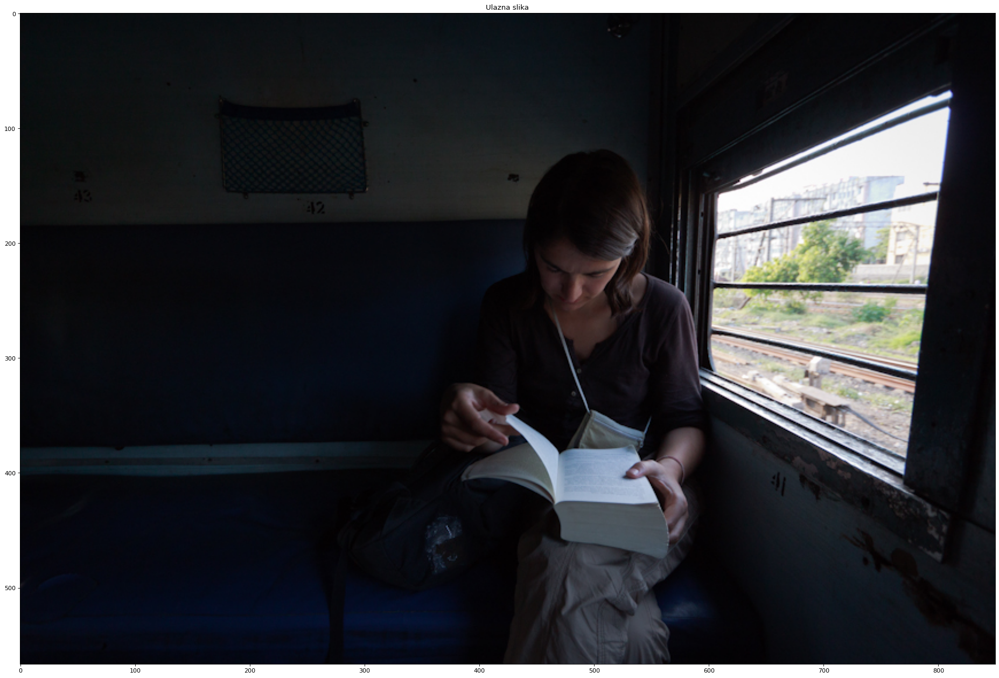

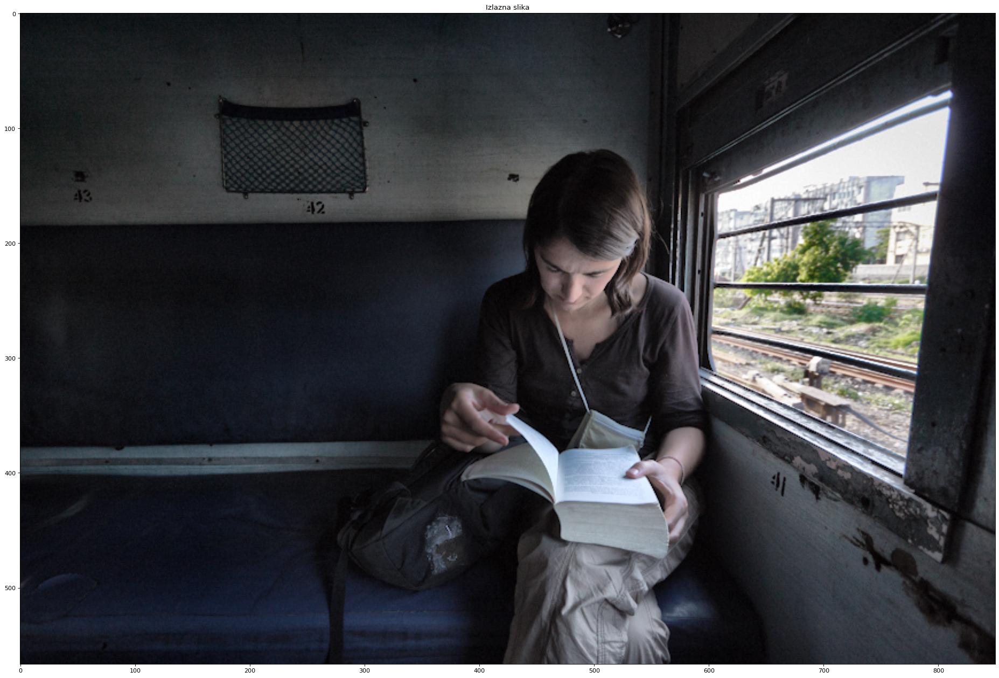

In [104]:
image3 = iio.imread('train.jpg')
plt.figure(figsize=(32,20), dpi=80); plt.imshow(image3)
plt.title("Ulazna slika")

img_new= dosCLAHE(image3,[8,8])
plt.figure(figsize=(32,20), dpi=80); plt.imshow(img_new)
plt.title("Izlazna slika")



# Razlicita vrednost blokova
- Sto vise povecavamo broj blokova histogram se racuna za manju povrsinu, odnosno u skladu je sa reionom gde pripada
- Na primer ako pogledamo predeo kroz prozor vidimo da se detalji bolje isticu sa povecanjem broja blokova
- Ali isto tako vidimo da tamniji delovi unutrasnjosti voza postaju tamniji jer se samo racuna histogram za njihov deo, na primer nisu uzeti u obizr i svetliji delovi oko prozora


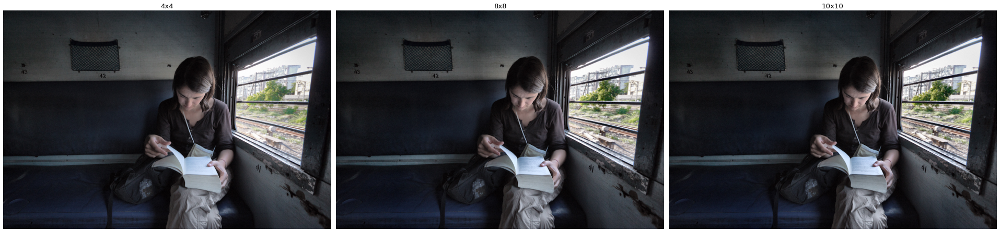

In [105]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(32,10), dpi=60)
ax = axes.ravel()

ax[0].imshow(dosCLAHE(image3, [4, 4])); ax[0].set_axis_off(); ax[0].set_title('4x4', fontsize=16)
ax[1].imshow(dosCLAHE(image3, [8,8])); ax[1].set_axis_off(); ax[1].set_title('8x8', fontsize=16)
ax[2].imshow(dosCLAHE(image3, [10,10])); ax[2].set_axis_off(); ax[2].set_title('10x10', fontsize=16)

plt.tight_layout()

# Razlicita vrednost limita
- Ako je mala vrednost klip limita dolazi do deformisanja slike, odnosno iskace sum
- Sto vise ogranicavamo maksimalnu vrednost histograma dobijamo bolje rezultate, iako je kontrast slabiji

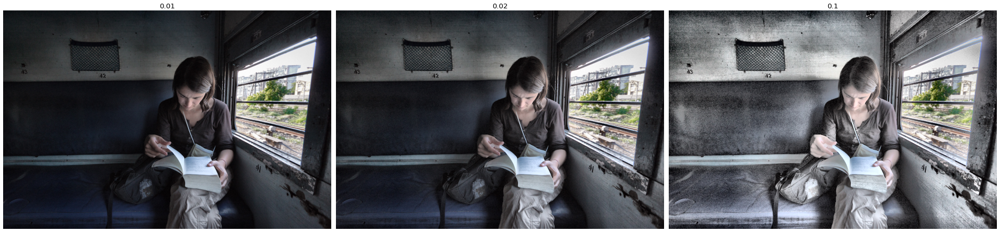

In [108]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(32,10), dpi=60)
ax = axes.ravel()

ax[0].imshow(dosCLAHE(image3, [8, 8], 0.01)); ax[0].set_axis_off(); ax[0].set_title('0.01', fontsize=16)
ax[1].imshow(dosCLAHE(image3, [8,8], 0.02)); ax[1].set_axis_off(); ax[1].set_title('0.02', fontsize=16)
ax[2].imshow(dosCLAHE(image3, [8,8], 0.1)); ax[2].set_axis_off(); ax[2].set_title('0.1', fontsize=16)

plt.tight_layout()

## Racunanje vremena - nasa funkcija

- vidi se iz dobijenog grafka da sto vise povecavamo broj blokova sve vise i vise vremena treba sto ima smisla vise izracunavanja ima
- ako povecavamo clip - limit manje je vremena potrebno , zapravo manje menjamo originalne histograme

7.039051264999574e-06
7.290793812431174e-06
7.488349044941749e-06
7.96442090894035e-06
3.741751090823217e-07
4.378012174243612e-07
4.3377076688633837e-07
3.776242922057905e-07


Text(0.5, 1.0, 'Zavisnost brzine izvrsavanja od ogranicenja kontrasta')

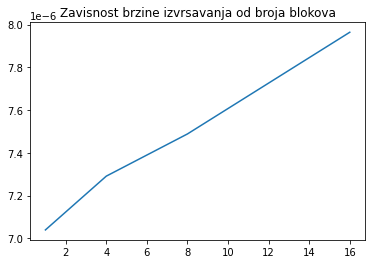

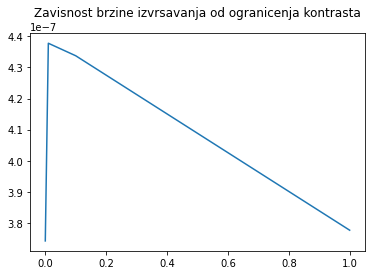

In [119]:
import time

dim = np.array([1,4,8,16])
limit = np.array([0, 0.01, 0.1, 1])

execution_time_dim = np.zeros((4,))
execution_time_limit = np.zeros((4,))

[height, width, planes] = shape(image3)
for i in range(0,4):

    start = time.time()


    img = dosCLAHE(image3, [dim[i], dim[i]] )

    end = time.time()
    execution_time_dim[i] = (end - start)
    execution_time_dim[i] = execution_time_dim[i]/np.size(image3)
    print(execution_time_dim[i])

for i in range(0,4):

    start = time.time()


    img = exposure.equalize_adapthist(image3, [8, 8], limit[i] )

    end = time.time()
    execution_time_limit[i] = (end - start)
    execution_time_limit[i] = execution_time_limit[i]/np.size(image3)
    print(execution_time_limit[i])

plt.figure()
plt.plot(dim, execution_time_dim)
plt.title("Zavisnost brzine izvrsavanja od broja blokova")

plt.figure()
plt.plot(limit, execution_time_limit)
plt.title("Zavisnost brzine izvrsavanja od ogranicenja kontrasta")



## Ugradjena funkcija

- ugradjena funkcija radi znatno brze ali malo vise i poremeti odnos boja

Text(0.5, 1.0, 'Izlazna slika')

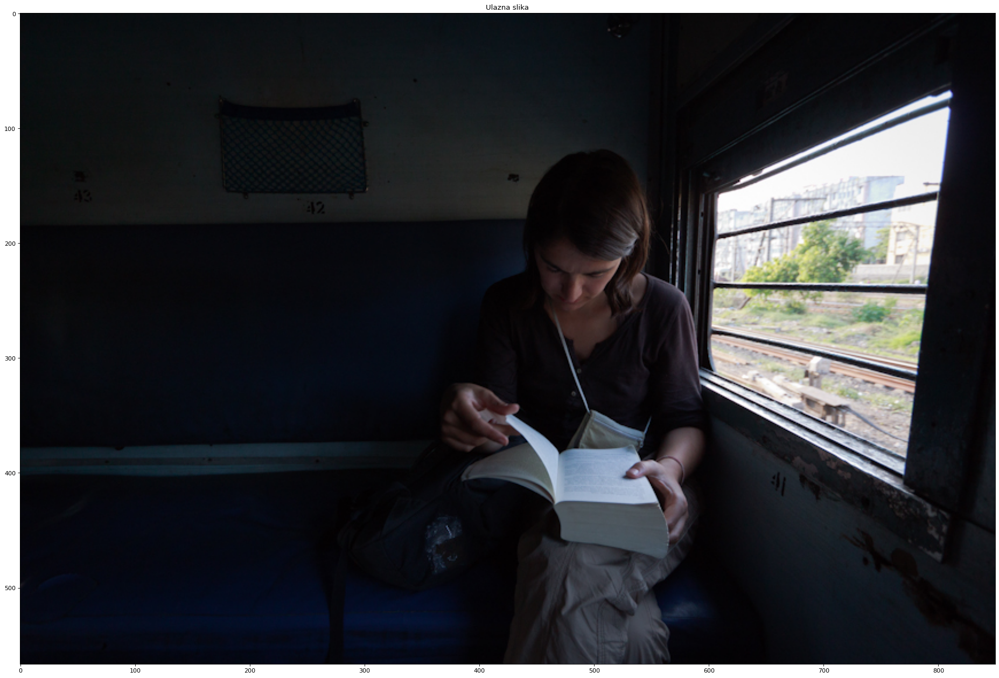

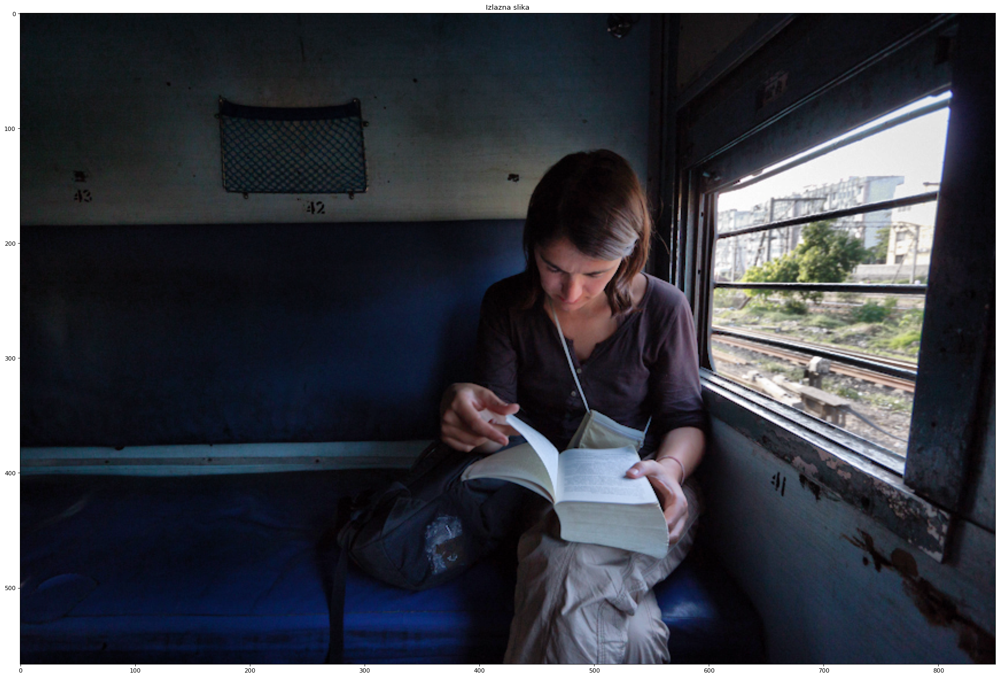

In [117]:
[height, width, planes] = shape(image3)
plt.figure(figsize=(32,20), dpi=80); plt.imshow(image3)
plt.title("Ulazna slika")

img_new=   exposure.equalize_adapthist(image3, [height/8, width/8],clip_limit=0.01)
plt.figure(figsize=(32,20), dpi=80); plt.imshow(img_new)
plt.title("Izlazna slika")

- Ugradjena funkcija je znatno brza i ima u sebi ugradjene optimizacije pa i vreme izvrsavanja se skracuje sa povecanjem broja blokova

4.0944740518880683e-07
2.628430236147314e-07
2.4987342228437477e-07
2.434575492161564e-07


Text(0.5, 1.0, 'Zavisnost brzine izvrsavanja od ogranicenja kontrasta')

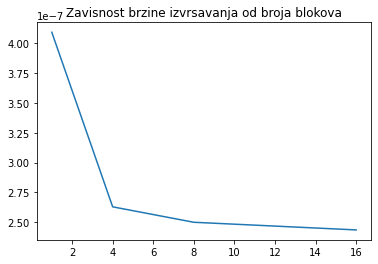

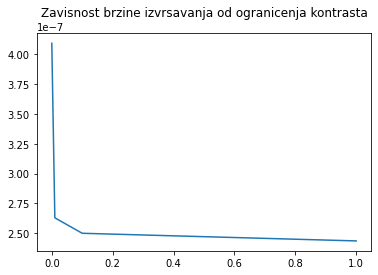

In [118]:


dim = np.array([1,4,8,16])
limit = np.array([0, 0.01, 0.1, 1])

execution_time_dim = np.zeros((4,))
execution_time_limit = np.zeros((4,))

[height, width, planes] = shape(image3)
for i in range(0,4):

    start = time.time()


    img = exposure.equalize_adapthist(image3, [height/dim[i],width/ dim[i]] )

    end = time.time()
    execution_time_dim[i] = (end - start)
    execution_time_dim[i] = execution_time_dim[i]/np.size(image3)
    print(execution_time_dim[i])

for i in range(0,4):

    start = time.time()


    img = exposure.equalize_adapthist(image3, [height/8,width/ 8], limit[i] )

    end = time.time()
    execution_time_limit[i] = (end - start)
    execution_time_limit[i] = execution_time_limit[i]/np.size(image3)
    print(execution_time_limit[i])

plt.figure()
plt.plot(dim, execution_time_dim)
plt.title("Zavisnost brzine izvrsavanja od broja blokova")

plt.figure()
plt.plot(limit, execution_time_limit)
plt.title("Zavisnost brzine izvrsavanja od ogranicenja kontrasta")
